In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymongo
from datetime import datetime

In [2]:
# Create connection variable
conn = 'mongodb://localhost:27017'

# Pass connection to the pymongo instance.
client = pymongo.MongoClient(conn)

# Connect to a database. Will create one if not already available.
db = client.opdcrime_db

# Define database and collection
collection = db.crimes

In [63]:
init_cat = 'Theft'
init_year = '2010'
init_time = 'Day'

init_objs = []
doy = []


for obj in db.crimes.find({}, {'_id': False}):
    count = 0
    datesplit = obj['date'].split('-')
    year = datesplit[0]
    intyear = int(datesplit[0])
    intmonth = int(datesplit[1])
    intday = int(datesplit[2])
    time_split = obj['time'].split(':')
    
    hour = int(time_split[0])
    if (hour > 5) and (hour < 18):
        time = 'Day'
    else:
        time = 'Night'
    init_objs.append(obj)
    
#    if (obj['category'] == init_cat) and (init_time == time):
#        init_objs.append(obj)
#        datesplit = obj['date'].split('-')
#        intyear = int(datesplit[0])
#        intmonth = int(datesplit[1])
#        intday = int(datesplit[2])
#    
#        x = datetime(intyear, intmonth, intday)
#    
#        day_of_year = x.timetuple().tm_yday
#        doy.append(day_of_year)
        
        
#    else:
#        next
        
#doy.sort()

#year_days = list(range(1,367))
#counts = []
#for i in year_days:
#    count = 0
#    for j in doy:
#        if i == j:
#            count = count + 1
#        else:
#            next
#    counts.append(count)

#counts


In [64]:
df = pd.DataFrame(list(init_objs))
df['date'] = df['date']+ ' ' + df['time']
df['date'] = pd.to_datetime(df['date'].astype(str), errors='coerce')
df['date'] = pd.to_datetime(df['date'], format = '%Y-%m-%d %H:%M:%S')
df = df.drop(['time'], axis = 1)
df.head()

,case_number,category,date,lat,lng,location
0,2013-00074238,Assault,2013-02-19 12:41:00,28.54518403,-81.40556136,Commercial/Office Building
1,2014-00326276,Theft,2014-08-06 02:55:00,28.44153996,-81.23261223,Construction Site
2,2014-00451565,Theft,2014-10-30 22:15:00,28.51884164,-81.46848512,Commercial/Office Building
3,2016-00007509,Assault,2016-01-06 10:39:00,28.52377872,-81.43230433,School
4,2011-00442271,Assault,2011-10-06 06:55:00,28.53921282,-81.38900691,Parking Lot - Surface


In [65]:
column_1 = df.ix[:,2]

data=pd.DataFrame({"year": column_1.dt.year,
              "month": column_1.dt.month,
              "day": column_1.dt.day,
#               "dayofyear": column_1.dt.dayofyear,
#               "week": column_1.dt.week,
#               "weekofyear": column_1.dt.weekofyear,
              "dayofweek": column_1.dt.dayofweek,
              "quarter": column_1.dt.quarter,
             })

/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  """Entry point for launching an IPython kernel.


In [66]:
dataset1=df.drop('date',axis=1)
data1=pd.concat([data,dataset1],axis=1)
data1.head()

,year,month,day,dayofweek,quarter,case_number,category,lat,lng,location
0,2013,2,19,1,1,2013-00074238,Assault,28.54518403,-81.40556136,Commercial/Office Building
1,2014,8,6,2,3,2014-00326276,Theft,28.44153996,-81.23261223,Construction Site
2,2014,10,30,3,4,2014-00451565,Theft,28.51884164,-81.46848512,Commercial/Office Building
3,2016,1,6,2,1,2016-00007509,Assault,28.52377872,-81.43230433,School
4,2011,10,6,3,4,2011-00442271,Assault,28.53921282,-81.38900691,Parking Lot - Surface


In [90]:
data = df.values
X = data[:, 0:6]
y = data[:, 5]
y

array(['Commercial/Office Building', 'Construction Site',
       'Commercial/Office Building', ..., 'Residence/Single',
       'Residence/Single', 'Grocery/Supermarket'], dtype=object)

In [91]:
from sklearn.preprocessing import LabelEncoder

# Step 1: Label-encode data set
label_encoder = LabelEncoder()
label_encoder.fit(y)
encoded_y = label_encoder.transform(y)

In [92]:
y_labels = []
for label, original_class in zip(encoded_y, y):
    print('Original Class: ' + str(original_class))
    print('Encoded Label: ' + str(label))
    print('-' * 12)
    y_labels.append(label)

Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Jail/Prison
Encoded Label: 39
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Highw

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Clas

------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Lab

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Mo

Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Mall
Encoded Label: 51
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Origina

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: School
Encoded Label: 63
---------

Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
----------

Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Orig

------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Construction Site
Encoded Label

Encoded Label: 35
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
----

Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Cell Phone Store
Encoded Label: 14
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
En

------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment

Encoded Label: 50
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Origi

Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Sporting Goods
Encoded Label: 66
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hardware Store
Encoded Label: 34
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: 

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------


------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Taxicab
Encoded Label: 68
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Video Store
Encoded Label: 75
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
---------

Original Class: Other
Encoded Label: 48
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Doctor/Dental Office
Encoded Label: 23
------------
Original

------------
Original Class: Doctor/Dental Office
Encoded Label: 23
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Singl

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Ap

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Dis

Original Class: Hardware Store
Encoded Label: 34
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Commercial/Office Building
Encod

------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Hardware Store
Encoded Label: 34
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Origin

Encoded Label: 52
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Hotel/Motel
Encoded Labe

Encoded Label: 58
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Labe

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartme

Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Auto Repair Shop
Encoded Label: 8
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Su

------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Pharmacy/Rest Home
Encoded Label: 54
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Laundromat/Dry Cleaner
Encoded Label: 42
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: R

Encoded Label: 5
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Origin

Encoded Label: 56
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Cl

Encoded Label: 19
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Orig

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Convenienc

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
-------

------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Lab

Encoded Label: 52
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Field/Woods
Encoded Label: 27
-----------

Encoded Label: 50
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Jail/Prison
Encoded Label: 39
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/C

------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Residence/Single
Encoded Label: 58
----------

Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Mall
Encoded Label: 51
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Clas

------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Clas

Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Electronic Store
Encoded Label: 26
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
--

------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Laundry Room
Encoded Label: 43
------------
Original Class: Auto Repair Shop
Encoded Label: 8
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Motor Vechicl

------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------


------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley

Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original C

Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
---------

Encoded Label: 65
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded La

------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartm

Encoded Label: 9
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Theater
Encoded Label: 69
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3


------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Enc

------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Cla

------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Or

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded 

Encoded Label: 47
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Auto Repair Shop
Encoded Label: 8
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
----------

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
----------

------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Parking Lot - Surface
Enc

Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single


------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Ori

------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Hotel/Motel
Encode

Encoded Label: 12
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Grocery/Supermarket
Encoded Label:

------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Doctor/Dental Office
Encoded Label: 23
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original

------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Theme Park
Encoded Label: 70
------------
Origina

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
-

Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Hardware Store
Encoded Label: 34
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall


------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Lab

Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Auto Repair Shop
Encoded Label: 8
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded L

Encoded Label: 3
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Liquor/Beer/Wine Store
Encoded Label: 45
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------


Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Laundromat/Dry Cleaner
Encoded Label: 42
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Vacant Apartment
Encoded Label: 72
------------


------------
Original Class: School
Encoded Label: 63
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park

Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
---

Encoded Label: 12
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: ATM/Depository
Encoded Label: 0
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Convenience Store
Encoded Label: 20
--

Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Clas

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Electronic Store
Encoded Label: 26
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single

Encoded Label: 18
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encode

------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Parking Lot - Surfa

------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Single
Encoded 

Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley


------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Doctor/Dental Office
Encoded Label: 23
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Commercial/Office Building
Enco

Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
---

Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: ATM/Depository
Encoded Label: 0
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Field/Woods


------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class

Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
En

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/S

------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Doctor/Dental Office
Encoded Label: 23
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------


Original Class: Other
Encoded Label: 48
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Con

Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theater
Encoded Label: 69
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Clas

Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Auto Repair Shop
Encoded Label: 8
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
-

------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Origina

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Specialty Store
Encoded Label: 65
--

Encoded Label: 18
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Cl

------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
----------

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Construction 

Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Ori

Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Electronic Store
Encoded Label: 26
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Recreation Faci

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Bank/Financial Institutio

------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Vacant Apartment
Encoded Label: 72
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encode

Encoded Label: 18
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Parking Garage
Encoded Label: 50
---------

Encoded Label: 56
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Labe

------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Recreati

------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: A

------------
Original Class: School
Encoded Label: 63
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class

Encoded Label: 9
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residenc

Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35


Encoded Label: 1
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Mall
Encoded Label: 51
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 3

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
En

Encoded Label: 46
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: School
Encoded Label: 63
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
-----------

Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: G

Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Cla

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: High

Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartmen

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Jewelry Store
Encoded Label: 40
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
----

Encoded Label: 10
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Parking Lot - Surface
Encode

Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Shelter/Transient
Encoded Label: 57
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking 

Encoded Label: 3
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Hardware Store
Encoded Label: 34
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
E

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
E

Encoded Label: 19
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Governemnt Building or Property
Encoded

Original Class: Other
Encoded Label: 48
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount 

Encoded Label: 22
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surfa

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded

Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Theme Park
Encod

Encoded Label: 48
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Othe

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley

------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
-

Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Furniture Shop
Encoded Label: 29
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: School
Encoded Label: 63
------------
Original Class: School
Encoded Label: 63
------------
Original

------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Origin

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Auto Repair Shop
Encoded Label: 8
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original C

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Departme

------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Liquor/Beer/Wine Store
Encoded Label: 45
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Mall
Encoded Label: 46
----------

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label:

Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded La

Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Doctor/Dental Office
Encoded Label: 23
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Origina

Encoded Label: 8
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------

Encoded Label: 58
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Other
Encoded Label: 56
--------

------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Convenience Store
Encoded Label: 20
-------

Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Cl

------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Bu

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Recreation Facility
Encoded Label: 55
----

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
---------

------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original

Encoded Label: 60
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Orig

Encoded Label: 63
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Pharmacy/Rest Home
Encoded Label: 54
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/

------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alle

Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Hi

Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------

------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Bar/Night Club/C

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label

------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 1

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Theme P

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Vacant/Commercial
Encoded Label: 74
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: C

------------
Original Class: Auto Parts Store
Encoded Label: 7
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Par

Encoded Label: 47
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Residence/Singl

Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bus/Rail Te

------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Cl

------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Furniture Shop
Encoded Label: 29
------------
Original Clas

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Hardware Store
Encoded Label: 34
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Ap

Encoded Label: 24
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
---------

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Enc

------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Pawn Shop
Encoded Label: 53
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
---

Encoded Label: 63
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: C

Encoded Label: 63
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
-------

Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Furniture Shop
Encoded Label: 29
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Taxicab
Encoded Label: 68
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 

Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Electronic Store
Encoded Label: 26
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded

------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Auto Dealer/Car Lot
Encoded Label: 6
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Vac

------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Mo

Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Vacant/Commercial
Encoded Label: 74
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Origi

Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Commercial/Office Building
Encoded Label: 18
-----------

------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Vacant Apartment
Encoded Label: 72
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road

Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Jail/Prison
Encoded Label: 39
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Specialty Store
Encoded Label: 65
-

Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Vacant Apartment
Encoded Label: 72
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apa

Encoded Label: 37
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Pawn Shop
Encoded Label: 53
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Origin

Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Highw

------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Governemnt Building or Property
Enc

Encoded Label: 58
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Liquor/Beer/Wine Store
Encoded Label: 45
------------
Original Class: Residence/Single
Encoded Labe

Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class:

------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Other
Encoded Label: 48
-----

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Cl

------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Other
Encoded Label: 48
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded L

Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Recreation Facility
Encoded Label: 55
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Reside

------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encode

Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Department/Discount Store

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Governemnt Building or Property

------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Bar/Night Club/Country Club
Encode

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Deliver Vechicle
Enc

------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Shelter/Tra

Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Electronic Store
Encoded Label: 26
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
-

------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 

Encoded Label: 22
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------

------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bus/Rail Terminal
Encoded Label: 12
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Or

------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: ATM/Depository
Encoded Label: 0
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Auto Parts Store
Encoded Label: 7
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Residence/Single
Enc

Encoded Label: 59
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Industrial/Mfg
Encoded Label: 38
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
O

Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Electronic Store
Encoded Label: 26
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
--------

------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Enc

------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
-----

Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Mall
Encoded Label: 46
------------
Original Clas

Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Church/Religious Building
Encoded Label: 16
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class

Encoded Label: 3
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Governemnt Building or Property
Encoded Label: 31
------------
Original Class: Residence/Si

Encoded Label: 70
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Barber/Beauty Shop
Encoded Label: 11
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Storage Unit
Encoded Label: 67
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Cl

Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Other Repair Facility
Encoded Label: 49
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Auto Repair Shop
Encoded Label: 8
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Apartment/

Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Hotel/Motel
Encoded Label: 37
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 1

Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Arena/Stadium
Encoded Label: 5
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Bus/Rail Terminal
Encoded 

Encoded Label: 3
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Restaurant/Other
Encoded Label: 61
------------
Original Class: Restaurant/Fine Dining
Encoded Label: 60
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Hospital
Encoded Label: 36
------

Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Parking Garage
Encoded Label: 50
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Clothing Store
Encoded Label: 17
------------
Original Class: Jewelry Store
Encoded Label: 40
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Re

Encoded Label: 11
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Laundromat/Dry Cleaner
Encoded Label: 42
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Apartment/C

Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Restaurant/Fast Food
Encoded Label: 59
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Airport
Encoded Label: 1
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original C

------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Gas Station
Encoded Label: 30
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
---------

Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Construction Site
Encoded Label: 19
------------
Original Class: Grocery/Supermarket
Encoded Label: 32
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Convenience Store
Encoded Label: 20
------------
Original Class: Parking Lot - Surface
Encoded Label: 52
------------
Origin

Encoded Label: 18
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Theme Park
Encoded Label: 70
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Field/Woods
Encoded Label: 27
------------
Original Class: Drug Store
Encoded Label: 24
------------
Original Class: Highway/Road/Alley
Encoded Label: 35
------------
Original Class: Bank/Financial Institution
Encoded Label: 9
------------
Original Class: School
Encoded Label: 63
------------
Original Class: Mall
Encoded Label: 46
------------
Original Class: Residence/Other
Encoded Label: 56
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Electronic Store
Encoded Label: 26
------------
Original Class: De

Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Bar/Night Club/Country Club
Encoded Label: 10
------------
Original Class: Department/Discount Store
Encoded Label: 22
------------
Original Class: Commercial/Office Building
Encoded Label: 18
------------
Original Class: Specialty Store
Encoded Label: 65
------------
Original Class: Motor Vechicle
Encoded Label: 47
------------
Original Class: Vacant House
Encoded Label: 73
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Residence/Single
Encoded Label: 58
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded Label: 3
------------
Original Class: Apartment/Condo
Encoded L

In [93]:
X = data[:, 0:6]
y = data[:, 1]

# Step 1: Label-encode data set
label_encoder = LabelEncoder()
label_encoder.fit(y)
encoded_y = label_encoder.transform(y)

z_labels = []
for label, original_class in zip(encoded_y, y):
    print('Original Class: ' + str(original_class))
    print('Encoded Label: ' + str(label))
    print('-' * 12)
    z_labels.append(label)

Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
E

Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Lab

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------


Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Origina

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Origi

Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Orig

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded La

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
E

Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded L

Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------


Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Cl

Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
-----------

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Origina

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
-----

Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
--------

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Clas

Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary


Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
-

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3


Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Cl

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Origi

Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded La

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
---

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original

Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
O

Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
-----------

Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
----

Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Ori

Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft


Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft


------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Ori

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary


------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Origi

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class:

Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
-----------

Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
---------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: The

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Cla

Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------

Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Enc

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encode

Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Th

Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Ori

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Thef

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Cla

Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded La

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Enc

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original

Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encode

Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assaul

Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
----

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded 

Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
--

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: 

Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary


Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
----------

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narco

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: T

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assa

Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
En

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
E

Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Enc

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Or

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Cl

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Thef

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft


Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Cla

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label

Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Enco

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original 

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encode

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encod

Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
---

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Labe

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
O

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded La

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Ori

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
-----

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
----

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Orig

Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
--------

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Ori

Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Enco

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery


Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
--

Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary


------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class

Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Homicide
Encoded Label: 6
------------
Original Class: Theft
Encode

Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
En

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original C

Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Enco

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
----------

Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
--

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Labe

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Rob

Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Kidnapping
Encoded Label: 7
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
---

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Clas

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Enco

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded La

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
-----------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglar

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Homicide
Encoded Label: 6
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcoti

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class

Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
----------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded 

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Cla

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Ori

Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
-----------

Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
---------

Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 1

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcot

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
--------

Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded La

Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded La

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: T

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Nar

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: The

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
----------

Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
-----------

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original C

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Nar

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Enco

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Enco

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Origin

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assau

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Origin

Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Enc

Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics


Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
----

Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Origin

Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Homicide
Encoded Label: 6
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Enco

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original C

Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Origin

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Nar

Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
---

Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
-----

Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
----

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Ori

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original C

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Bur

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Origin

Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded 

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Th

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotic

------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary


Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded L

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Origi

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
-------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fr

Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud


------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fra

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
En

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Or

Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
---------

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Labe

Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class:

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded 

Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burgla

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Or

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 

Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Enco

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Labe

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burg

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: The

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
En

Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Clas

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original 

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
-----------

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: The

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Thef

Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
---

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------


Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
---------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Clas

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: 

Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
-------

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
--------

Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
----

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Ass

Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
O

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encode

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
O

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
En

Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
----------

Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original 

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label:

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
En

Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label:

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
E

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded L

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Homicide
Encoded Label: 6
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original 

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcot

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
--

Original Class: Arson
Encoded Label: 0
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label:

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encode

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original 

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded L

Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcot

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Origina

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Origi

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class

Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
E

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
E

Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Origi

Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------

Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Cl

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 1

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class:

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
---------

Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label:

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Cla

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Clas

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
-

Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10


------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original 

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
E

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
---------

------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burgla

Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
-

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
O

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: The

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Origina

Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Orig

Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Ori

Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: T

Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Enco

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
--------

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Lab

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Clas

Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: As

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narc

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Thef

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Thef

Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded 

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
----------

Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
-

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Cla

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Or

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Labe

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Origina

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------

Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Ori

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assaul

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Cl

Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded La

Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 

Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
----

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
--------

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Lab

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
-----

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud


Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle 

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
O

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft


------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: As

Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robb

Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
En

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Origi

Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------


------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: The

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Origi

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burgl

Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
-------

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Orig

------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Enc

Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
---------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Enco

------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: 

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Orig

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assaul

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Origin

Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
--------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original C

Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
-----------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
E

Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 

Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
----------

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
E

Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
-------

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Or

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbe

Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------

------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Cl

Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
O

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Labe

Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Clas

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Origin

Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
----

Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Enco

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft

Encoded Label: 9
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
-----

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
O

------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Cla

Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
En

Encoded Label: 1
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
----

------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Kidnapping
Encoded Label: 7
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Thef

------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Cla

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: 

Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
----

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Orig

Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
Encoded Label: 8
------

Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
-----------

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Narcotics
E

------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------


Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Kidnapping
Encoded Label: 7
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded L

Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Lab

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Labe

Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Lab

Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
---

Original Class: Fraud
Encoded Label: 5
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Homicide
Encoded Label: 6
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: F

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
-----

Encoded Label: 8
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
--------

Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encod

Original Class: Fraud
Encoded Label: 5
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Arson
Encoded Label: 0
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Labe

Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original

Encoded Label: 5
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Fraud
Encoded Label: 5
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Burglary
Encoded Label: 3
---

Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Vehicle Theft
Encoded Label: 11
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Assault
Encoded Label: 1
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Theft
Encoded Label: 10
------------
Original Class: Robbery
Encoded Label: 9
------------
Original Class: Narcotics
Encoded Label: 8
------------
Original Class: Theft
Encoded

In [95]:
data1['loc_num'] = y_labels
data1['cat_num'] = z_labels
data1.head()

,year,month,day,dayofweek,quarter,case_number,category,lat,lng,location,cat_num,loc_num
0,2013,2,19,1,1,2013-00074238,Assault,28.54518403,-81.40556136,Commercial/Office Building,1,18
1,2014,8,6,2,3,2014-00326276,Theft,28.44153996,-81.23261223,Construction Site,10,19
2,2014,10,30,3,4,2014-00451565,Theft,28.51884164,-81.46848512,Commercial/Office Building,10,18
3,2016,1,6,2,1,2016-00007509,Assault,28.52377872,-81.43230433,School,1,63
4,2011,10,6,3,4,2011-00442271,Assault,28.53921282,-81.38900691,Parking Lot - Surface,1,52


In [96]:
model_10_df = data1.loc[data1['cat_num'].isin(['10'])]
model_10_df.head()

,year,month,day,dayofweek,quarter,case_number,category,lat,lng,location,cat_num,loc_num
1,2014,8,6,2,3,2014-00326276,Theft,28.44153996,-81.23261223,Construction Site,10,19
2,2014,10,30,3,4,2014-00451565,Theft,28.51884164,-81.46848512,Commercial/Office Building,10,18
6,2014,11,20,3,4,2014-00480257,Theft,28.5401689,-81.38495135,Highway/Road/Alley,10,35
7,2013,2,17,6,1,2013-00800478,Theft,28.53175319,-81.43435271,Apartment/Condo,10,3
8,2011,12,9,4,4,2011-00539015,Theft,28.57805144,-81.42803164,Commercial/Office Building,10,18


In [98]:
month = model_10_df.groupby('month')
month = month['cat_num'].count()
month = month.reset_index()
month.head()

,month,cat_num
0,1,5179
1,2,4549
2,3,5117
3,4,5255
4,5,5545


In [100]:
X = month.month.values.reshape(-1, 1)
y = month.cat_num.values.reshape(-1, 1)

print("Shape: ", X.shape, y.shape)

Shape:  (12, 1) (12, 1)


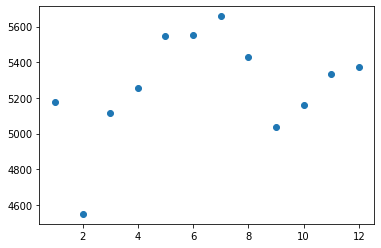

In [101]:
plt.scatter(X, y)

In [102]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [103]:
model.fit(X, y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [104]:
print('Weight coefficients: ', model.coef_)
print('y-axis intercept: ', model.intercept_)

Weight coefficients:  [[28.56993007]]
y-axis intercept:  [5079.87878788]


In [105]:
x_min = np.array([[X.min()]])
x_max = np.array([[X.max()]])
y_min = model.predict(x_min)
y_max = model.predict(x_max)

Text(0.5, 0, 'Month')

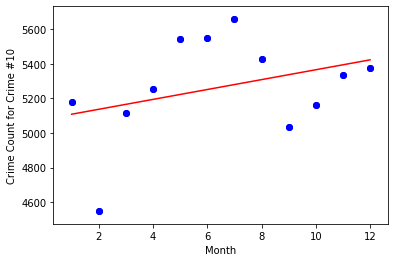

In [106]:
plt.scatter(X, y, c='blue')
plt.scatter(X, y, c='blue')
plt.plot([x_min[0], x_max[0]], [y_min[0], y_max[0]], c='red')
plt.ylabel(f'Crime Count for Crime #10')
plt.xlabel('Month')

In [107]:
week = model_10_df.groupby('dayofweek')
week = week['cat_num'].count()
week = week.reset_index()
week.head()

,dayofweek,cat_num
0,0,10643
1,1,9704
2,2,9559
3,3,9261
4,4,9229


In [108]:
X = week.dayofweek.values.reshape(-1, 1)
y = week.cat_num.values.reshape(-1, 1)

print("Shape: ", X.shape, y.shape)

Shape:  (7, 1) (7, 1)


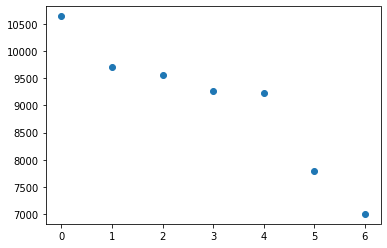

In [109]:
plt.scatter(X, y)

In [110]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X, y)
print('Weight coefficients: ', model.coef_)
print('y-axis intercept: ', model.intercept_)

Weight coefficients:  [[-538.67857143]]
y-axis intercept:  [10642.75]


Text(0.5, 0, 'Week')

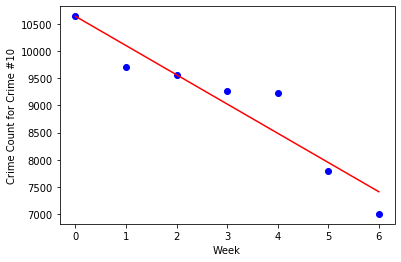

In [111]:
x_min = np.array([[X.min()]])
x_max = np.array([[X.max()]])
y_min = model.predict(x_min)
y_max = model.predict(x_max)
plt.scatter(X, y, c='blue')
plt.plot([x_min[0], x_max[0]], [y_min[0], y_max[0]], c='red')
plt.ylabel(f'Crime Count for Crime #10')
plt.xlabel('Week')

In [114]:
model_201_df = data1.loc[data1['cat_num'].isin(['1'])]
model_201_df.head()

,year,month,day,dayofweek,quarter,case_number,category,lat,lng,location,cat_num,loc_num
0,2013,2,19,1,1,2013-00074238,Assault,28.54518403,-81.40556136,Commercial/Office Building,1,18
3,2016,1,6,2,1,2016-00007509,Assault,28.52377872,-81.43230433,School,1,63
4,2011,10,6,3,4,2011-00442271,Assault,28.53921282,-81.38900691,Parking Lot - Surface,1,52
21,2015,1,8,3,1,2015-00010028,Assault,28.47874533,-81.44227024,Apartment/Condo,1,3
30,2011,2,18,4,1,2011-00078986,Assault,28.55281938,-81.41229452,Parking Lot - Surface,1,52


In [115]:
month = model_201_df.groupby('month')
month = month['cat_num'].count()
month = month.reset_index()
month.head()

,month,cat_num
0,1,1116
1,2,1022
2,3,1197
3,4,1137
4,5,1286


In [116]:
X = month.month.values.reshape(-1, 1)
y = month.cat_num.values.reshape(-1, 1)

print("Shape: ", X.shape, y.shape)

Shape:  (12, 1) (12, 1)


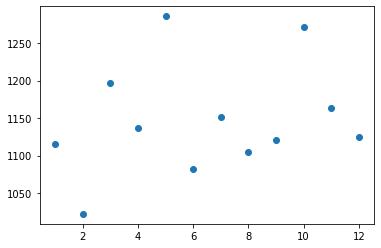

In [117]:
plt.scatter(X, y)

In [118]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X, y)
print('Weight coefficients: ', model.coef_)
print('y-axis intercept: ', model.intercept_)

Weight coefficients:  [[4.71328671]]
y-axis intercept:  [1117.53030303]


Text(0.5, 0, 'Month')

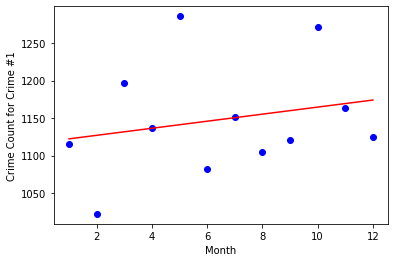

In [119]:
x_min = np.array([[X.min()]])
x_max = np.array([[X.max()]])
y_min = model.predict(x_min)
y_max = model.predict(x_max)
plt.scatter(X, y, c='blue')
plt.plot([x_min[0], x_max[0]], [y_min[0], y_max[0]], c='red')
plt.ylabel(f'Crime Count for Crime #1')
plt.xlabel('Month')

In [120]:
week = model_201_df.groupby('dayofweek')
week = week['cat_num'].count()
week = week.reset_index()
week.head()

,dayofweek,cat_num
0,0,1884
1,1,1718
2,2,1878
3,3,1772
4,4,1952


In [121]:
X = week.dayofweek.values.reshape(-1, 1)
y = week.cat_num.values.reshape(-1, 1)

print("Shape: ", X.shape, y.shape)

Shape:  (7, 1) (7, 1)


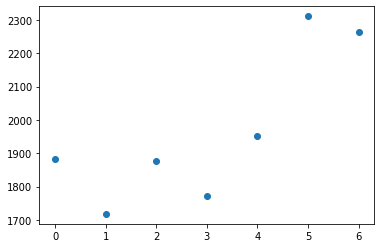

In [122]:
plt.scatter(X, y)

In [123]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X, y)
print('Weight coefficients: ', model.coef_)
print('y-axis intercept: ', model.intercept_)

Weight coefficients:  [[85.60714286]]
y-axis intercept:  [1711.46428571]


Text(0.5, 0, 'Week')

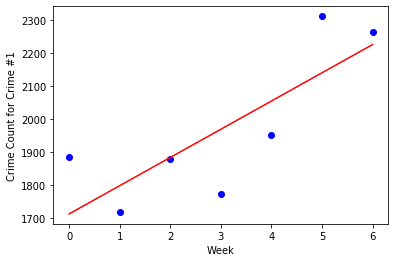

In [124]:
x_min = np.array([[X.min()]])
x_max = np.array([[X.max()]])
y_min = model.predict(x_min)
y_max = model.predict(x_max)
plt.scatter(X, y, c='blue')
plt.plot([x_min[0], x_max[0]], [y_min[0], y_max[0]], c='red')
plt.ylabel(f'Crime Count for Crime #1')
plt.xlabel('Week')

In [146]:
model_small_df = data1.loc[data1['cat_num'].isin(['10'])]
model_small_df.head()

,year,month,day,dayofweek,quarter,case_number,category,lat,lng,location,cat_num,loc_num
1,2014,8,6,2,3,2014-00326276,Theft,28.44153996,-81.23261223,Construction Site,10,19
2,2014,10,30,3,4,2014-00451565,Theft,28.51884164,-81.46848512,Commercial/Office Building,10,18
6,2014,11,20,3,4,2014-00480257,Theft,28.5401689,-81.38495135,Highway/Road/Alley,10,35
7,2013,2,17,6,1,2013-00800478,Theft,28.53175319,-81.43435271,Apartment/Condo,10,3
8,2011,12,9,4,4,2011-00539015,Theft,28.57805144,-81.42803164,Commercial/Office Building,10,18


In [147]:
model_small_df = model_small_df[['case_number','cat_num','loc_num']]

In [150]:
model_small_df = model_small_df.fillna(0)
model_small_df.reset_index()
model_small_df['case_number'] = model_small_df['case_number'].replace('-', '', regex=True)
model_small_df.head()

,case_number,cat_num,loc_num
1,201400326276,10,19
2,201400451565,10,18
6,201400480257,10,35
7,201300800478,10,3
8,201100539015,10,18


In [152]:
model_small_df['case_number'] = model_small_df['case_number'].apply(pd.to_numeric, errors='coerce')

model_small_df['cat_num'] = model_small_df['cat_num'].apply(pd.to_numeric, errors='coerce')

model_small_df['loc_num'] = model_small_df['loc_num'].apply(pd.to_numeric, errors='coerce')

In [153]:
model_small_df = model_small_df.fillna(0)
model_small_df.reset_index()
model_small_df.head(5)

,case_number,cat_num,loc_num
1,201400326276,10,19
2,201400451565,10,18
6,201400480257,10,35
7,201300800478,10,3
8,201100539015,10,18


In [154]:
X = model_small_df.drop("loc_num", axis=1)
y = model_small_df["loc_num"]
print(X.shape, y.shape)

(63187, 2) (63187,)


In [157]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1)

In [160]:
from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression()
classifier

classifier.fit(X_train, y_train)

print(f"Training Data Score: {classifier.score(X_train, y_train)}")
print(f"Testing Data Score: {classifier.score(X_test, y_test)}")

predictions = classifier.predict(X_test)
print(f"First 10 Predictions:   {predictions[:30]}")
print(f"First 10 Actual labels: {y_test[:30].tolist()}")

/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Training Data Score: 0.1489132728423718
Testing Data Score: 0.1509780338038868
First 10 Predictions:   [3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3]
First 10 Actual labels: [32, 3, 46, 58, 46, 35, 12, 20, 22, 32, 17, 17, 52, 12, 58, 3, 17, 17, 52, 3, 37, 35, 32, 22, 58, 3, 22, 35, 63, 58]


In [161]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=20)
rf = rf.fit(X, y)
rf.score(X, y)

0.17945146944782947

In [162]:
importances = rf.feature_importances_
importances

array([1., 0.])

In [163]:
from sklearn.model_selection import GridSearchCV
param_grid = {'C': [1, 5, 10, 50]}
grid = GridSearchCV(classifier, param_grid, verbose=3)

In [164]:
grid.fit(X, y)

/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:657: Warning: The least populated class in y has only 1 members, which is too few. The minimum number of members in any class cannot be less than n_splits=3.
  % (min_groups, self.n_splits)), Warning)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:46

Fitting 3 folds for each of 4 candidates, totalling 12 fits
[CV] C=1 .............................................................
[CV] ................................. C=1, score=0.149, total=   2.0s
[CV] C=1 .............................................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.0s remaining:    0.0s
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................. C=1, score=0.149, total=   1.9s
[CV] C=1 .............................................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    3.9s remaining:    0.0s
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................. C=1, score=0.150, total=   2.0s
[CV] C=5 .............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................. C=5, score=0.149, total=   1.9s
[CV] C=5 .............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................. C=5, score=0.149, total=   2.0s
[CV] C=5 .............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................. C=5, score=0.150, total=   1.9s
[CV] C=10 ............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................ C=10, score=0.149, total=   1.8s
[CV] C=10 ............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................ C=10, score=0.149, total=   1.9s
[CV] C=10 ............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................ C=10, score=0.150, total=   1.9s
[CV] C=50 ............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................ C=50, score=0.149, total=   2.0s
[CV] C=50 ............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................ C=50, score=0.149, total=   2.0s
[CV] C=50 ............................................................


/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


[CV] ................................ C=50, score=0.150, total=   1.8s


[Parallel(n_jobs=1)]: Done  12 out of  12 | elapsed:   23.1s finished
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/davidwilliams/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


GridSearchCV(cv='warn', error_score='raise-deprecating',
             estimator=LogisticRegression(C=1.0, class_weight=None, dual=False,
                                          fit_intercept=True,
                                          intercept_scaling=1, l1_ratio=None,
                                          max_iter=100, multi_class='warn',
                                          n_jobs=None, penalty='l2',
                                          random_state=None, solver='warn',
                                          tol=0.0001, verbose=0,
                                          warm_start=False),
             iid='warn', n_jobs=None, param_grid={'C': [1, 5, 10, 50]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=3)

In [165]:
print(grid.best_params_)

{'C': 1}


In [166]:
print(grid.best_score_)

0.14942947125199804


In [167]:
predictions = grid.predict(X)

In [182]:
target_list = []
for x in range(77):
    if x == 0:
        next
    else:
        target_list.append(str(x))

from sklearn.metrics import classification_report
print(classification_report(y, predictions,
                            target_names=target_list))

              precision    recall  f1-score   support

           1       0.00      0.00      0.00        17
           2       0.00      0.00      0.00      2280
           3       0.00      0.00      0.00         5
           4       0.15      1.00      0.26      9442
           5       0.00      0.00      0.00         5
           6       0.00      0.00      0.00       237
           7       0.00      0.00      0.00       250
           8       0.00      0.00      0.00        44
           9       0.00      0.00      0.00       143
          10       0.00      0.00      0.00       194
          11       0.00      0.00      0.00      2584
          12       0.00      0.00      0.00        59
          13       0.00      0.00      0.00       540
          14       0.00      0.00      0.00         2
          15       0.00      0.00      0.00        48
          16       0.00      0.00      0.00         3
          17       0.00      0.00      0.00       291
          18       0.00    

In [183]:
#KNN
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=1000)
knn.fit(X_train,y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=1000, p=2,
                     weights='uniform')

In [184]:
knn.score(X_test,y_test)

0.17091852883458886

In [185]:
knn.score(X_train,y_train)

0.17431947668284448

k: 1, Train/Test Score: 1.000/0.107
k: 3, Train/Test Score: 0.427/0.125
k: 5, Train/Test Score: 0.349/0.133
k: 7, Train/Test Score: 0.316/0.140
k: 9, Train/Test Score: 0.290/0.144
k: 11, Train/Test Score: 0.272/0.143
k: 13, Train/Test Score: 0.257/0.144
k: 15, Train/Test Score: 0.247/0.147
k: 17, Train/Test Score: 0.237/0.150
k: 19, Train/Test Score: 0.230/0.148


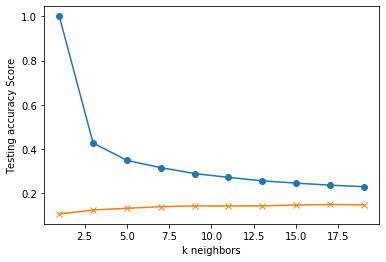

In [190]:
train_scores = []
test_scores = []
for k in range(1, 20, 2):
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train, y_train)
    train_score = knn.score(X_train, y_train)
    test_score = knn.score(X_test, y_test)
    train_scores.append(train_score)
    test_scores.append(test_score)
    print(f"k: {k}, Train/Test Score: {train_score:.3f}/{test_score:.3f}")
    
    
plt.plot(range(1, 20, 2), train_scores, marker='o')
plt.plot(range(1, 20, 2), test_scores, marker="x")
plt.xlabel("k neighbors")
plt.ylabel("Testing accuracy Score")
plt.show()